In [26]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [27]:
import os

In [28]:
!pip install keras-unet

In [29]:
import keras
from keras_unet.models import custom_unet

In [30]:
NPYPATH = '/raid/mpsych/RISTERLAB/fly_segmentation_experiments/data_dir/test2/pre_processing/npy/'
MODELPATH = '/raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/'
images_file = os.path.join(NPYPATH, 'original.npy')
labels_file = os.path.join(NPYPATH, 'mask.npy')

In [31]:
images = np.load(images_file)
labels = np.load(labels_file)

In [32]:
images.shape

(1812, 512, 512)

In [33]:
labels.shape

(1812, 512, 512)

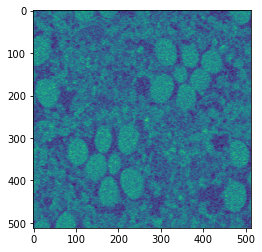

In [34]:
imshow(images[1000])

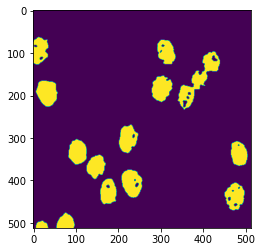

In [35]:
imshow(labels[1000])

In [36]:
images = np.expand_dims(images, axis=3)
labels = np.expand_dims(labels, axis=3)

In [37]:
random_indices = np.random.choice(1812, 400)

In [38]:
training_images = np.empty([400, 512, 512, 1])
training_labels = np.empty([4400, 512, 512, 1])
z = 0

for i in random_indices:
    training_images[z] = images[i]
    training_labels[z] = labels[i]
    z = z + 1

In [39]:
training_images.shape

(400, 512, 512, 1)

In [40]:
training_images = training_images.astype(np.float64)
training_labels = training_labels.astype(np.float64)

In [41]:
p = np.random.permutation(len(training_images))

In [42]:
training_images = training_images[p]
training_labels = training_labels[p]

In [43]:
import tensorflow as tf

In [44]:
all_images = []
all_labels = []

for i in range(training_images.shape[0]):
    training_images[i] = (training_images[i] - training_images[i].min()) / (training_images[i].max() - training_images[i].min()) # normalize individually
    
    mask = training_labels[i]
    image = training_images[i]
    
    all_images.append(image)
    all_labels.append(mask)

    image1 = tf.image.flip_left_right(image)
    mask1 = tf.image.flip_left_right(mask)
    
    all_images.append(image1)
    all_labels.append(mask1)
    

    image2 = tf.image.flip_up_down(image)
    mask2 = tf.image.flip_up_down(mask)
    
    all_images.append(image2)
    all_labels.append(mask2)

    image3 = tf.image.rot90(image)
    mask3 = tf.image.rot90(mask)
    
    all_images.append(image3)
    all_labels.append(mask3)

In [45]:
all_images = np.array(all_images).astype(np.float64)
all_labels = np.array(all_labels).astype(np.float64)

In [46]:
all_images.shape

(1600, 512, 512, 1)

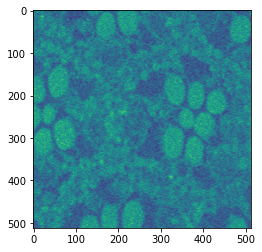

In [47]:
imshow(all_images[100])

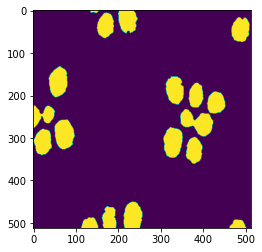

In [48]:
imshow(all_labels[100])

In [49]:
X_train = all_images[0:1200]
y_train = all_labels[0:1200]
X_val = all_images[1200:1400]
y_val = all_labels[1200:1400]
X_test = all_images[1400:]
y_test = all_labels[1400:]

In [57]:
import keras.optimizers
from keras_unet.metrics import iou, iou_thresholded
from keras_unet.losses import jaccard_distance
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import EarlyStopping

early_stop = EarlyStopping(
    monitor='val_accuracy', 
    patience=300, 
    min_delta=0.001, 
    mode='max'
)

model = custom_unet(
    input_shape=(512, 512, 1),
    use_batch_norm=False,
    num_classes=1,
    filters=32,
    dropout=0.5,
    output_activation='sigmoid')

filepath = (os.path.join(MODELPATH, '04-07-32-300-{epoch:02d}-{val_loss:.2f}-{loss:.2f}-{accuracy:.2f}.hdf5'))

checkpoint = ModelCheckpoint(filepath,
                             monitor='val_loss', 
                             verbose=1,
                             save_best_only=False,
                             mode='auto', 
                             period=1)

opt = keras.optimizer_v1.Adam(lr=0.01)

model.compile(optimizer = 'Adam',    
              loss='binary_crossentropy', 
              metrics=[iou, iou_thresholded, 'accuracy'])

history = model.fit(X_train, 
                    y_train, 
                    32, 
                    epochs=300,
                    validation_data=(X_val, y_val), 
                    verbose=1,
                    callbacks=[checkpoint, early_stop])

Epoch 1/300
38/38 [==============================] - 14s 338ms/step - loss: 0.4304 - iou: 0.0572 - iou_thresholded: 0.0019 - accuracy: 0.8806 - val_loss: 0.3299 - val_iou: 0.0923 - val_iou_thresholded: 1.7000e-06 - val_accuracy: 0.8910

Epoch 00001: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-01-0.33-0.43-0.88.hdf5
Epoch 2/300
38/38 [==============================] - 12s 327ms/step - loss: 0.3318 - iou: 0.0926 - iou_thresholded: 3.0540e-06 - accuracy: 0.8861 - val_loss: 0.3076 - val_iou: 0.1034 - val_iou_thresholded: 1.7000e-06 - val_accuracy: 0.8910

Epoch 00002: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-02-0.31-0.33-0.89.hdf5
Epoch 3/300
38/38 [==============================] - 13s 330ms/step - loss: 0.2976 - iou: 0.1238 - iou_thresholded: 0.0011 - accuracy: 0.8861 - val_loss: 0.2212 - val_iou: 0.1659 - val_iou_thresholded: 1.0959e-04 - val_accurac

38/38 [==============================] - 12s 329ms/step - loss: 0.0630 - iou: 0.7128 - iou_thresholded: 0.7912 - accuracy: 0.9733 - val_loss: 0.0988 - val_iou: 0.5489 - val_iou_thresholded: 0.6142 - val_accuracy: 0.9571

Epoch 00022: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-22-0.10-0.06-0.97.hdf5
Epoch 23/300
38/38 [==============================] - 12s 327ms/step - loss: 0.0605 - iou: 0.7197 - iou_thresholded: 0.7960 - accuracy: 0.9741 - val_loss: 0.0835 - val_iou: 0.6013 - val_iou_thresholded: 0.6713 - val_accuracy: 0.9635

Epoch 00023: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-23-0.08-0.06-0.97.hdf5
Epoch 24/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0605 - iou: 0.7225 - iou_thresholded: 0.7978 - accuracy: 0.9744 - val_loss: 0.0909 - val_iou: 0.5592 - val_iou_thresholded: 0.6322 - val_accuracy: 0.9593

Epoch 00024: sa


Epoch 00043: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-43-0.07-0.04-0.98.hdf5
Epoch 44/300
38/38 [==============================] - 12s 329ms/step - loss: 0.0427 - iou: 0.7955 - iou_thresholded: 0.8542 - accuracy: 0.9820 - val_loss: 0.0774 - val_iou: 0.6427 - val_iou_thresholded: 0.7207 - val_accuracy: 0.9693

Epoch 00044: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-44-0.08-0.04-0.98.hdf5
Epoch 45/300
38/38 [==============================] - 12s 327ms/step - loss: 0.0419 - iou: 0.7985 - iou_thresholded: 0.8552 - accuracy: 0.9822 - val_loss: 0.1194 - val_iou: 0.5941 - val_iou_thresholded: 0.6491 - val_accuracy: 0.9616

Epoch 00045: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-45-0.12-0.04-0.98.hdf5
Epoch 46/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0435 - i

38/38 [==============================] - 13s 337ms/step - loss: 0.0307 - iou: 0.8485 - iou_thresholded: 0.8923 - accuracy: 0.9870 - val_loss: 0.0735 - val_iou: 0.7232 - val_iou_thresholded: 0.7612 - val_accuracy: 0.9741

Epoch 00065: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-65-0.07-0.03-0.99.hdf5
Epoch 66/300
38/38 [==============================] - 13s 333ms/step - loss: 0.0303 - iou: 0.8508 - iou_thresholded: 0.8940 - accuracy: 0.9872 - val_loss: 0.0621 - val_iou: 0.7344 - val_iou_thresholded: 0.7775 - val_accuracy: 0.9761

Epoch 00066: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-66-0.06-0.03-0.99.hdf5
Epoch 67/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0303 - iou: 0.8500 - iou_thresholded: 0.8936 - accuracy: 0.9872 - val_loss: 0.0700 - val_iou: 0.7369 - val_iou_thresholded: 0.7794 - val_accuracy: 0.9763

Epoch 00067: sa


Epoch 00086: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-86-0.07-0.03-0.99.hdf5
Epoch 87/300
38/38 [==============================] - 13s 335ms/step - loss: 0.0237 - iou: 0.8811 - iou_thresholded: 0.9168 - accuracy: 0.9901 - val_loss: 0.0766 - val_iou: 0.7530 - val_iou_thresholded: 0.7894 - val_accuracy: 0.9775

Epoch 00087: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-87-0.08-0.02-0.99.hdf5
Epoch 88/300
38/38 [==============================] - 13s 330ms/step - loss: 0.0228 - iou: 0.8860 - iou_thresholded: 0.9198 - accuracy: 0.9905 - val_loss: 0.0829 - val_iou: 0.7405 - val_iou_thresholded: 0.7719 - val_accuracy: 0.9753

Epoch 00088: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-88-0.08-0.02-0.99.hdf5
Epoch 89/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0229 - i

38/38 [==============================] - 13s 330ms/step - loss: 0.0201 - iou: 0.8993 - iou_thresholded: 0.9290 - accuracy: 0.9916 - val_loss: 0.0763 - val_iou: 0.7782 - val_iou_thresholded: 0.8017 - val_accuracy: 0.9791

Epoch 00108: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-108-0.08-0.02-0.99.hdf5
Epoch 109/300
38/38 [==============================] - 13s 336ms/step - loss: 0.0192 - iou: 0.9028 - iou_thresholded: 0.9322 - accuracy: 0.9920 - val_loss: 0.0794 - val_iou: 0.7865 - val_iou_thresholded: 0.8101 - val_accuracy: 0.9801

Epoch 00109: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-109-0.08-0.02-0.99.hdf5
Epoch 110/300
38/38 [==============================] - 12s 327ms/step - loss: 0.0188 - iou: 0.9053 - iou_thresholded: 0.9338 - accuracy: 0.9922 - val_loss: 0.0838 - val_iou: 0.7862 - val_iou_thresholded: 0.8098 - val_accuracy: 0.9798

Epoch 00110


Epoch 00129: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-129-0.08-0.02-0.99.hdf5
Epoch 130/300
38/38 [==============================] - 13s 331ms/step - loss: 0.0166 - iou: 0.9152 - iou_thresholded: 0.9408 - accuracy: 0.9930 - val_loss: 0.0974 - val_iou: 0.7882 - val_iou_thresholded: 0.8051 - val_accuracy: 0.9795

Epoch 00130: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-130-0.10-0.02-0.99.hdf5
Epoch 131/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0163 - iou: 0.9176 - iou_thresholded: 0.9420 - accuracy: 0.9932 - val_loss: 0.0774 - val_iou: 0.7802 - val_iou_thresholded: 0.8063 - val_accuracy: 0.9796

Epoch 00131: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-131-0.08-0.02-0.99.hdf5
Epoch 132/300
38/38 [==============================] - 12s 327ms/step - loss: 0.01

38/38 [==============================] - 12s 328ms/step - loss: 0.0147 - iou: 0.9248 - iou_thresholded: 0.9471 - accuracy: 0.9938 - val_loss: 0.0802 - val_iou: 0.7982 - val_iou_thresholded: 0.8172 - val_accuracy: 0.9809

Epoch 00151: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-151-0.08-0.01-0.99.hdf5
Epoch 152/300
38/38 [==============================] - 13s 330ms/step - loss: 0.0143 - iou: 0.9271 - iou_thresholded: 0.9488 - accuracy: 0.9940 - val_loss: 0.0772 - val_iou: 0.7937 - val_iou_thresholded: 0.8128 - val_accuracy: 0.9805

Epoch 00152: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-152-0.08-0.01-0.99.hdf5
Epoch 153/300
38/38 [==============================] - 13s 333ms/step - loss: 0.0142 - iou: 0.9274 - iou_thresholded: 0.9491 - accuracy: 0.9940 - val_loss: 0.0738 - val_iou: 0.7990 - val_iou_thresholded: 0.8177 - val_accuracy: 0.9810

Epoch 00153


Epoch 00172: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-172-0.08-0.01-0.99.hdf5
Epoch 173/300
38/38 [==============================] - 12s 329ms/step - loss: 0.0164 - iou: 0.9187 - iou_thresholded: 0.9421 - accuracy: 0.9932 - val_loss: 0.0991 - val_iou: 0.7946 - val_iou_thresholded: 0.8133 - val_accuracy: 0.9804

Epoch 00173: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-173-0.10-0.02-0.99.hdf5
Epoch 174/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0168 - iou: 0.9155 - iou_thresholded: 0.9416 - accuracy: 0.9931 - val_loss: 0.0742 - val_iou: 0.7925 - val_iou_thresholded: 0.8160 - val_accuracy: 0.9808

Epoch 00174: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-174-0.07-0.02-0.99.hdf5
Epoch 175/300
38/38 [==============================] - 13s 337ms/step - loss: 0.01

38/38 [==============================] - 13s 337ms/step - loss: 0.0126 - iou: 0.9356 - iou_thresholded: 0.9549 - accuracy: 0.9948 - val_loss: 0.0914 - val_iou: 0.8078 - val_iou_thresholded: 0.8206 - val_accuracy: 0.9812

Epoch 00194: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-194-0.09-0.01-0.99.hdf5
Epoch 195/300
38/38 [==============================] - 12s 328ms/step - loss: 0.0124 - iou: 0.9367 - iou_thresholded: 0.9555 - accuracy: 0.9948 - val_loss: 0.0930 - val_iou: 0.8036 - val_iou_thresholded: 0.8172 - val_accuracy: 0.9811

Epoch 00195: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-195-0.09-0.01-0.99.hdf5
Epoch 196/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0119 - iou: 0.9381 - iou_thresholded: 0.9566 - accuracy: 0.9950 - val_loss: 0.0865 - val_iou: 0.8010 - val_iou_thresholded: 0.8168 - val_accuracy: 0.9810

Epoch 00196


Epoch 00215: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-215-0.10-0.01-1.00.hdf5
Epoch 216/300
38/38 [==============================] - 13s 335ms/step - loss: 0.0106 - iou: 0.9446 - iou_thresholded: 0.9610 - accuracy: 0.9955 - val_loss: 0.0951 - val_iou: 0.8097 - val_iou_thresholded: 0.8206 - val_accuracy: 0.9814

Epoch 00216: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-216-0.10-0.01-1.00.hdf5
Epoch 217/300
38/38 [==============================] - 12s 327ms/step - loss: 0.0129 - iou: 0.9355 - iou_thresholded: 0.9547 - accuracy: 0.9947 - val_loss: 0.0713 - val_iou: 0.7989 - val_iou_thresholded: 0.8148 - val_accuracy: 0.9808

Epoch 00217: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-217-0.07-0.01-0.99.hdf5
Epoch 218/300
38/38 [==============================] - 13s 332ms/step - loss: 0.01

38/38 [==============================] - 13s 331ms/step - loss: 0.0102 - iou: 0.9470 - iou_thresholded: 0.9629 - accuracy: 0.9957 - val_loss: 0.0884 - val_iou: 0.8099 - val_iou_thresholded: 0.8208 - val_accuracy: 0.9814

Epoch 00237: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-237-0.09-0.01-1.00.hdf5
Epoch 238/300
38/38 [==============================] - 13s 333ms/step - loss: 0.0108 - iou: 0.9443 - iou_thresholded: 0.9607 - accuracy: 0.9955 - val_loss: 0.0756 - val_iou: 0.8094 - val_iou_thresholded: 0.8232 - val_accuracy: 0.9817

Epoch 00238: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-238-0.08-0.01-1.00.hdf5
Epoch 239/300
38/38 [==============================] - 12s 326ms/step - loss: 0.0114 - iou: 0.9416 - iou_thresholded: 0.9593 - accuracy: 0.9953 - val_loss: 0.1050 - val_iou: 0.7918 - val_iou_thresholded: 0.8033 - val_accuracy: 0.9794

Epoch 00239


Epoch 00258: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-258-0.10-0.01-1.00.hdf5
Epoch 259/300
38/38 [==============================] - 12s 328ms/step - loss: 0.0096 - iou: 0.9502 - iou_thresholded: 0.9650 - accuracy: 0.9959 - val_loss: 0.0899 - val_iou: 0.8044 - val_iou_thresholded: 0.8160 - val_accuracy: 0.9809

Epoch 00259: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-259-0.09-0.01-1.00.hdf5
Epoch 260/300
38/38 [==============================] - 13s 332ms/step - loss: 0.0095 - iou: 0.9507 - iou_thresholded: 0.9655 - accuracy: 0.9960 - val_loss: 0.1021 - val_iou: 0.8125 - val_iou_thresholded: 0.8221 - val_accuracy: 0.9817

Epoch 00260: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-260-0.10-0.01-1.00.hdf5
Epoch 261/300
38/38 [==============================] - 12s 329ms/step - loss: 0.00

38/38 [==============================] - 13s 332ms/step - loss: 0.0093 - iou: 0.9518 - iou_thresholded: 0.9660 - accuracy: 0.9961 - val_loss: 0.0935 - val_iou: 0.8126 - val_iou_thresholded: 0.8235 - val_accuracy: 0.9818

Epoch 00280: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-280-0.09-0.01-1.00.hdf5
Epoch 281/300
38/38 [==============================] - 12s 328ms/step - loss: 0.0096 - iou: 0.9502 - iou_thresholded: 0.9654 - accuracy: 0.9960 - val_loss: 0.1020 - val_iou: 0.8107 - val_iou_thresholded: 0.8204 - val_accuracy: 0.9815

Epoch 00281: saving model to /raid/mpsych/RISTERLAB/fly_segmentation_experiments/classified_images/models/04-07/04-07-32-300-281-0.10-0.01-1.00.hdf5
Epoch 282/300
38/38 [==============================] - 13s 333ms/step - loss: 0.0094 - iou: 0.9509 - iou_thresholded: 0.9658 - accuracy: 0.9960 - val_loss: 0.0906 - val_iou: 0.8134 - val_iou_thresholded: 0.8241 - val_accuracy: 0.9820

Epoch 00282

from keras_unet.utils import plot_segm_history

plot_segm_history(history)

In [58]:
y_pred = model.predict(X_test)

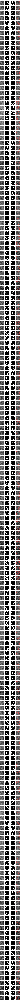

In [60]:
from keras_unet.utils import plot_imgs

plot_imgs(org_imgs=X_test, mask_imgs=y_test, pred_imgs=y_pred, nm_img_to_plot=200)

In [61]:
y_predict = model.predict(X_val)

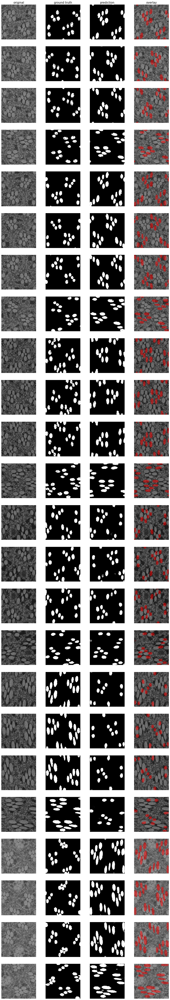

In [62]:
plot_imgs(org_imgs=X_val, mask_imgs=y_val, pred_imgs=y_pred, nm_img_to_plot=24)

In [69]:
images[100].shape

(512, 512, 1)

In [68]:
np.expand_dims(images[100], axis=0).shape

(1, 512, 512, 1)

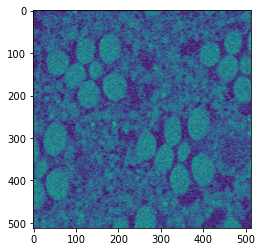

In [64]:
imshow(images[100])

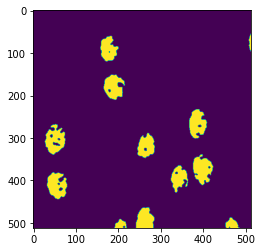

In [73]:
imshow(labels[100])

In [70]:
y_prediction_test = model.predict(np.expand_dims(images[100], axis=0))

In [71]:
y_prediction_test.shape

(1, 512, 512, 1)

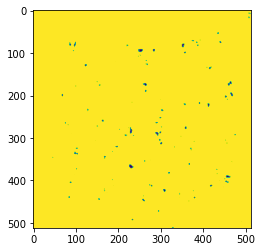

In [74]:
imshow(y_prediction_test[0])

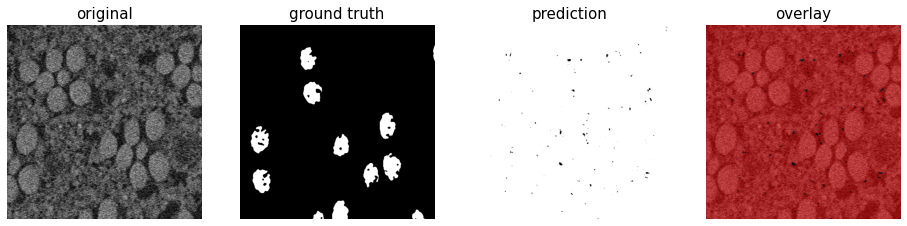

In [75]:
plot_imgs(org_imgs=np.expand_dims(images[100], axis=0), mask_imgs=np.expand_dims(labels[100], axis=0), pred_imgs=y_prediction_test, nm_img_to_plot=1)